In [482]:
import numpy as np
import matplotlib.pyplot as plt 
import math

In [493]:
class SOM(object):
    def __init__(self, eta=0.01, n_iter=50):
        self.eta = eta
        self.n_iter = n_iter
        self.W_ = np.array( [] )

    def __dist(self, A,B):
        sum=0
        for i in range (0,A.shape[0]):
            sum += (A[i]-B[i])**2
        return np.sqrt(sum)
  
    def __normalisation(self,winner):
        val=0.0
        for i in range(0,self.W_.shape[1]):
            val+=self.W_[winner][i]**2
        val=np.sqrt(val)
        for i in range(0,self.W_.shape[1]):
            if self.W_[winner][i] != 0 and val != 0:
                self.W_[winner][i]/=val  
        return self
                    
  
    def __winner(self, p ):
        calculated=9999999
        winner_index = 0
        for i in range(0,self.W_.shape[0]):
              if calculated > self.__dist( p,self.W_[i]):
                calculated = self.__dist( p,self.W_[i])
                winner_index = i
        return winner_index, calculated
  
    def __returnSquere(self,radius,winner_index):
        
        side_len = int(math.sqrt(self.W_.shape[0]))
        
        col_w = winner_index % side_len
        row_w = winner_index // side_len 
        
        for_chage = []
        
        edge_col = col_w - radius
        edge_row = row_w - radius
        
        for i in range(0,radius * 2 + 1):
            for j in range(0,radius * 2 + 1):
                if edge_row >= 0 and edge_row < side_len and edge_col >= 0 and edge_col < side_len:
                    for_chage.append(edge_col + edge_row * (side_len))
                edge_col += 1 
            edge_row += 1
            edge_col = col_w - radius
        return for_chage

    
    def __returnCircle(self,radius,winner_index):
        
        side_len = int(math.sqrt(self.W_.shape[0]))
        
        x = np.arange(0, side_len)
        y = np.arange(0, side_len)
        
        arr = np.zeros((y.size, x.size))
        
        cx = winner_index % side_len - 1
        cy = winner_index // side_len  
        
        mask = (x[np.newaxis,:]-cx)**2 + (y[:,np.newaxis]-cy)**2 < (radius+1)**2
        arr[mask] = 1.
        
        # print(arr)
        for_chage = []
        
        for i in range(0,arr.shape[0]):
            for j in range(0,arr.shape[0]):
                if arr[i][j] == 1:
                    for_chage.append(arr.shape[0] * i + j)
            
        # plt.figure(figsize=(6, 6))
        # plt.pcolormesh(x, y, arr)
        # plt.colorbar()
        # plt.show()
    
        return for_chage    
    
    def WTA(self,winner,p,normalize=False):
        for indeks in range(0,self.W_.shape[1]):
            self.W_[winner][indeks]=self.W_[winner][indeks]+self.eta*1*(p[indeks]-self.W_[winner][indeks])
        
        if normalize:
            self.__normalisation(winner)
        
        return self  
  


    def WTA_iter(self,X,n_iter,b_normalize):
        input_winner_list=[]
        weights_list=[]
        for _ in range(n_iter):      
            for p_indeks in range( len(X) ):
                weights_list.append(np.array(self.W_))
                winner = som.winner(X[p_indeks])
                input_winner_list.append(winner)
                som.WTA(winner[0],X[p_indeks],b_normalize)
        return input_winner_list,weights_list  
    
    
    def __WTM(self,winner,p,normalize=False):
        for i in range(0,self.W_.shape[1]):
              self.W_[winner][i]=self.W_[winner][i]+self.eta*1*(p[i]-self.W_[winner][i]) # co jest p ? 
        if normalize:
            self.__normalisation(winner)
        return self
  


    def WTM_iter(self,X_out,n_iter = 10, neighborhood_type = 0,neighborhood_range = 1,with_nomalisation = False):
        X = np.copy(X_out)
        

        
        input_winner_list=[]
        weights_list=[]
        for _ in range(n_iter):      
            for p_indeks in range( len(X) ):
                weights_list.append(np.array(self.W_))
                winner = self.__winner(X[p_indeks])
                input_winner_list.append(winner)
                
                if neighborhood_type == 1:
                    winners_list = self.__returnCircle(int(neighborhood_range),winner[0])
                else:
                    winners_list = self.__returnSquere(int(neighborhood_range),winner[0])
                
                for i in range(0,len(winners_list)):
                    self.__WTM(winners_list[i],X[p_indeks],with_nomalisation)
                    
            self.eta *=0.9
            neighborhood_range *=0.9
                

        
        return input_winner_list,weights_list  
    
    
    
    def show(self, data, width, height, nrows, type_s = 0):

        if type_s == 0:
            fi,ax = plt.subplots(nrows = nrows, ncols = int(len(data)/nrows), sharex=True, sharey=True)
            k=0
            if nrows == 1 and int(len(data)/nrows) == 1:
                    img = self.W_.reshape(width,height,3)
                    ax.imshow(img)
            elif nrows == 1:
                for j in range(0,int(len(data)/nrows)):
                    img = self.W_.reshape(width,height,3)
                    ax[j].imshow(img)
                    k += 1
            elif int(len(data)/nrows) == 1:
                for j in range(0,nrows):
                    img = self.W_.reshape(width,height,3)
                    ax[j].imshow(img)
                    k += 1
            else:
                for i in range(0,nrows):
                    for j in range(0,int(len(data)/nrows)):
                        img = self.W_.reshape(width,height,3)
                        ax[i][j].imshow(img)
                        k += 1
        else:
            for result_indeks in range(len(winners)-1):
                fig, ax = plt.subplots(nrows=1, ncols=1, sharex=True, sharey=True)

                img = data[result_indeks].reshape(width,height,3)
                ax.imshow(img)

In [494]:
def normalize( INPUT ):
    val=0.0
    for i in range(0,INPUT.shape[0]):
        val+=INPUT[i]**2
    val=np.sqrt(val)

    for i in range(0,INPUT.shape[0]):
        if val != 0 and INPUT[i] != 0:
            INPUT[i]/=val
    return INPUT

In [495]:
width = 100
height = 100
rgen = np.random.RandomState(1)
bitmap1=rgen.choice(range(255),size=width*height*3).reshape(width*height,3)
bitmap2 = np.copy(bitmap1)
bitmap3 = np.copy(bitmap1)
bitmap4 = np.copy(bitmap1)
bitmap1 = np.array(bitmap1, dtype = 'float64')

for i in range(bitmap1.shape[0]):
    normalize(bitmap1[i])

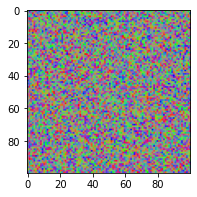

In [496]:
img = bitmap1.reshape(width,height,3)
fig, ax = plt.subplots(nrows=1, ncols=1, sharex=True, sharey=True)

fig.set_size_inches(3, 3)

ax.imshow(img)

In [497]:
rgen = np.random.RandomState(1)
bitmap2 = np.array(bitmap2, dtype = 'float64')

for i in range(bitmap2.shape[0]):
    normalize(bitmap2[i])

C:\Users\KirVin\AppData\Local\Temp/ipykernel_4848/945641548.py:173: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=1, sharex=True, sharey=True)


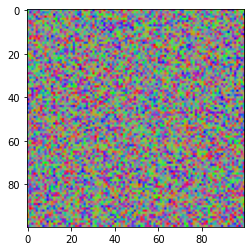

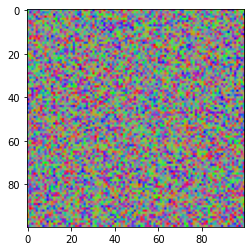

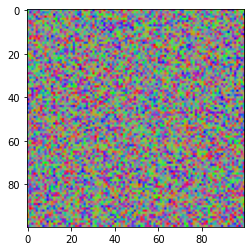

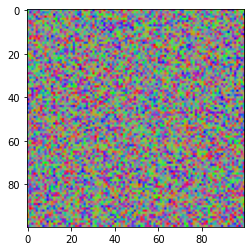

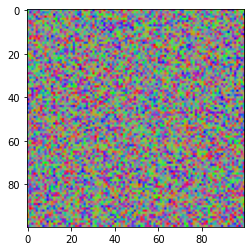

...

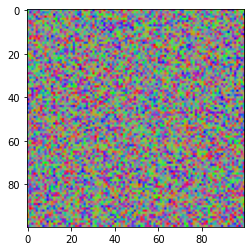

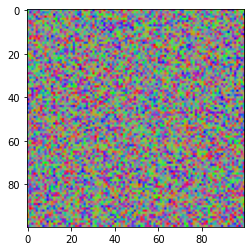

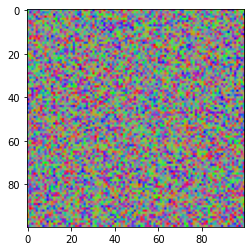

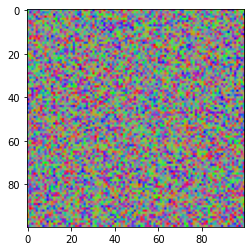

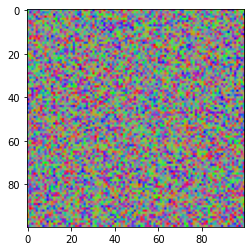

In [498]:
som1=SOM(eta=0.1)
som1.W_=bitmap2
X=np.array( [[1.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,1.0],[1.0,1.0,0.0]] )
winners,weights=som1.WTA_iter(X,10,False)
som1.show(weights,width,height,1,1)

In [499]:

rgen = np.random.RandomState(1)
bitmap3 = np.array(bitmap3, dtype = 'float64')

for i in range(bitmap3.shape[0]):
    normalize(bitmap3[i])

C:\Users\KirVin\AppData\Local\Temp/ipykernel_4848/945641548.py:173: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=1, sharex=True, sharey=True)


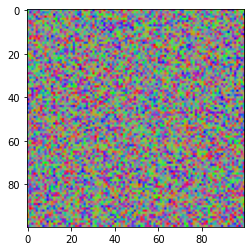

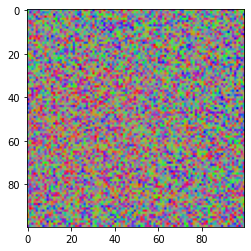

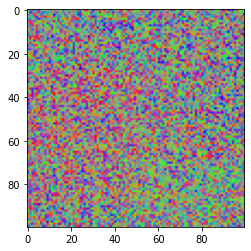

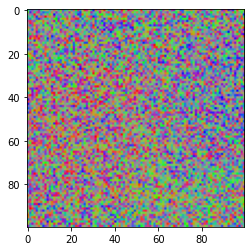

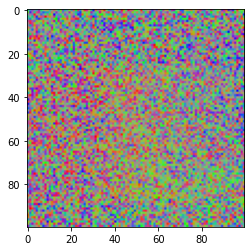

...

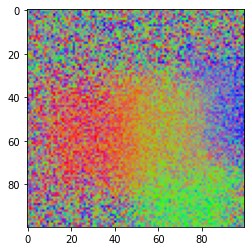

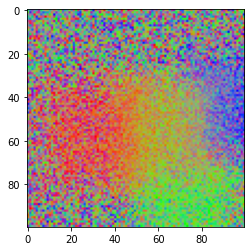

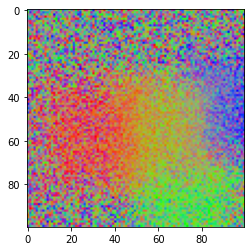

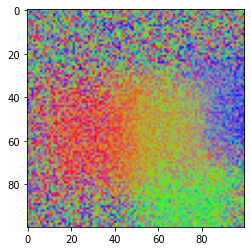

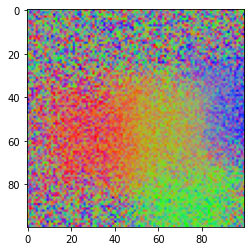

In [500]:
som2=SOM(eta=0.1)
som2.W_=bitmap3
X=np.array( [[1.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,1.0],[1.0,1.0,0.0]] )
winners,weights=som2.WTM_iter(X ,10,0,30, True)
som2.show(weights,width,height,1,1)

In [501]:

rgen = np.random.RandomState(1)
bitmap4 = np.array(bitmap4, dtype = 'float64')

for i in range(bitmap4.shape[0]):
    normalize(bitmap4[i])

C:\Users\KirVin\AppData\Local\Temp/ipykernel_4848/945641548.py:173: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=1, sharex=True, sharey=True)


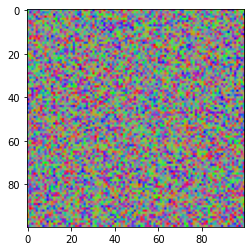

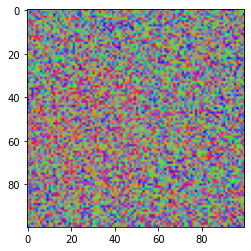

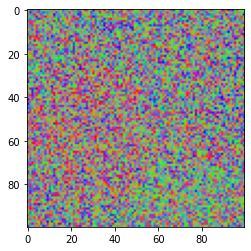

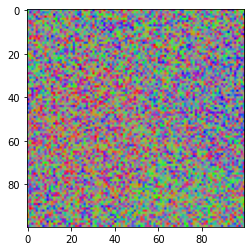

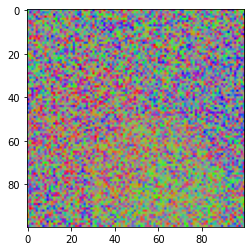

...

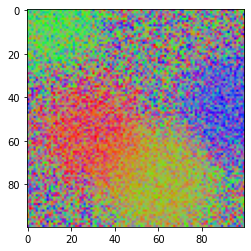

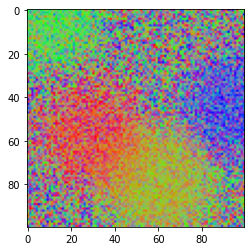

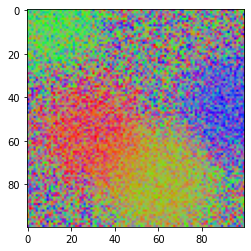

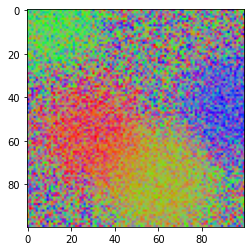

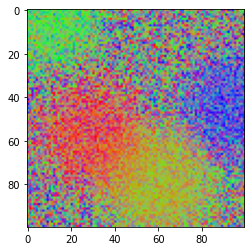

In [502]:
som3=SOM(eta=0.1)
som3.W_=bitmap4
X=np.array( [[1.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,1.0],[1.0,1.0,0.0]] )
winners,weights=som3.WTM_iter(X ,10,1,30, True)
som3.show(weights,width,height,1,1)